In [1]:
%cd /content

/content


# *Hi, THE FOLLOWING STEPS ARE DONE TO EXPLORE DATA AND CREATE TRAIN AND TEST DATA*

In [1]:
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu,corpus_bleu
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


In [2]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('/content/vgg16_lstm')

**Hi, don't forget to first upload the data on your own drive, and make sure there are no restrictions involved through drive.**

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!unzip /content/drive/MyDrive/Filckr8k.zip

Streaming output truncated to the last 5000 lines.
  inflating: Filckr8k/Images/2844846111_8c1cbfc75d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2844846111_8c1cbfc75d.jpg  
  inflating: Filckr8k/Images/1082252566_8c79beef93.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1082252566_8c79beef93.jpg  
  inflating: Filckr8k/Images/1386251841_5f384a0fea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1386251841_5f384a0fea.jpg  
  inflating: Filckr8k/Images/2196316998_3b2d63f01f.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2196316998_3b2d63f01f.jpg  
  inflating: Filckr8k/Images/3106791484_13e18c33d8.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3106791484_13e18c33d8.jpg  
  inflating: Filckr8k/Images/3603064161_a8f3b6455d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3603064161_a8f3b6455d.jpg  
  inflating: Filckr8k/Images/2293149170_38fb2257ea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2293149170_38fb2257ea.jpg  
  inflating: Filckr8k/Images/2451114871_8617ae2f16.jpg  
  inflating: __MA

In [5]:
image_data_location = "/content/Filckr8k/Images"
caption_data_location = "/content/Filckr8k/captions_images.txt"

In [6]:
df = pd.read_csv(caption_data_location)

In [7]:
df.head()

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   image    40455 non-null  object
 1   caption  40455 non-null  object
dtypes: object(2)
memory usage: 632.2+ KB


In [9]:
train_data_df = df.iloc[:40000,:]
test_data_df = df.iloc[40000:,:]

In [10]:
train_data_df.tail()

,image,caption
39995,887108308_2da97f15ef.jpg,A child walks while holding an adult 's hand .
39996,887108308_2da97f15ef.jpg,A man holds a child 's hand as they walk .
39997,887108308_2da97f15ef.jpg,A woman walks hand-in-hand with a little boy w...
39998,887108308_2da97f15ef.jpg,A young boy has his hand in the back of his pa...
39999,887108308_2da97f15ef.jpg,The man is walking with a young child outside .


In [11]:
test_data_df.head()

,image,caption
40000,888425986_e4b6c12324.jpg,A boy is upside down in midair near a lake at ...
40001,888425986_e4b6c12324.jpg,A person does a flip by two sailboats and a la...
40002,888425986_e4b6c12324.jpg,A person flipping upside down
40003,888425986_e4b6c12324.jpg,a person in midair doing a back flip .
40004,888425986_e4b6c12324.jpg,A person is doing a flip in midair near a lake...


In [12]:
train_data_df.to_csv('train_captions.txt',index = False)
test_data_df.to_csv('test_captions.txt', index = False)

In [13]:
train_data_location = '/content/train_captions.txt'
test_data_location = '/content/test_captions.txt'

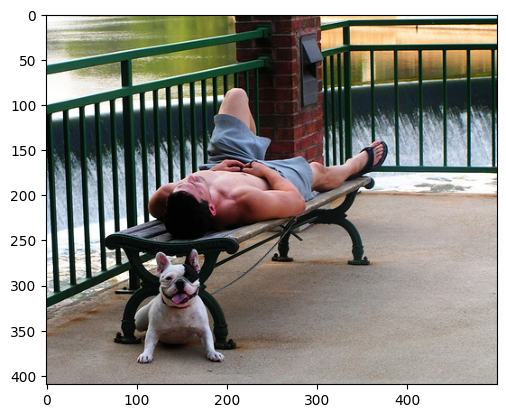

Caption - A man lays on the bench to which a white dog is also tied .
Caption - a man sleeping on a bench outside with a white and black dog sitting next to him .
Caption - A shirtless man lies on a park bench with his dog .
Caption - man laying on bench holding leash of dog sitting on ground
Caption - A man in an orange hat starring at something .


In [14]:
data_idx = 16
image_path = image_data_location + "/" + df.iloc[data_idx,0]
# print( df.iloc[data_idx,:])
img = mpimg.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(data_idx, data_idx+5):
    print(f"Caption - {df.iloc[i,1]}")

In [15]:
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T

In [16]:
spacy_eng = spacy.load('en_core_web_sm')
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

# Creating the vacabulary class 

This class creates the actual mapping of the words to its integer and vice-versa. This helps in assiging a numerical value to a word, that can be easily processed by the model.

This class also keeps track of the different words in the "vocabulary" of the model.

In [17]:
class Vocabulary:
    def __init__(self,freq_threshold):
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        self.stoi = {v:k for k,v in self.itos.items()}
        self.freq_threshold = freq_threshold
    
    def __len__(self):
        return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self,sentence_list):
        frequencies = Counter()
        idx = 4
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text]
                
                

In [18]:
v = Vocabulary(freq_threshold=1)
v.build_vocab(["This is a new city"])
print(v.stoi)
print(v.numericalize("This is a new city"))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'this': 4, 'is': 5, 'a': 6, 'new': 7, 'city': 8}
[4, 5, 6, 7, 8]


In [19]:
df = pd.read_csv(caption_data_location)
print(df["image"][0][::-1])

gpj.e0bc80b396_1028620001


# Creating the dataset class

The instance of this class is the actual data that is fed to the model. As the data is huge, we will define a loader class, that gets data in batches to avoid any memory or overflow errors.

This class returns the transformed image and its tokenized caption tensor.

In [20]:
class CustomDataset(Dataset):
    def __init__(self,root_dir,captions_file,transform=None, freq_threshold=5):
        self.root_dir = root_dir
        self.df = pd.read_csv(captions_file)
        
        self.transform = transform
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        if self.transform is not None:
            img = self.transform(img)
            
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [21]:
#defing the transform to be applied
transforms = T.Compose([
    T.Resize((224,224)),
    T.ToTensor()
])

In [22]:
def show_image(inp, title=None):
    """Imshow for Tensor"""
    inp = inp.numpy().transpose((1,2,0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

In [23]:
# testing the dataset
dataset = CustomDataset(
        root_dir = image_data_location,
        captions_file = train_data_location,
        transform = transforms
)

In [24]:
print(len(dataset))

40000


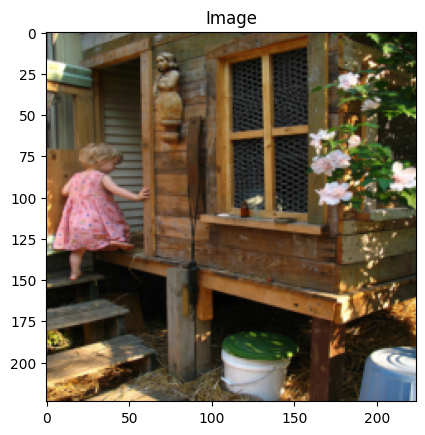

Token : tensor([  1,   4,   7, 316,  76,   4, 157,  74,   5,   2])
Sentence: 
['<SOS>', 'a', 'girl', 'going', 'into', 'a', 'wooden', 'building', '.', '<EOS>']


In [25]:
img, caps = dataset[1]
# print(caps)
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

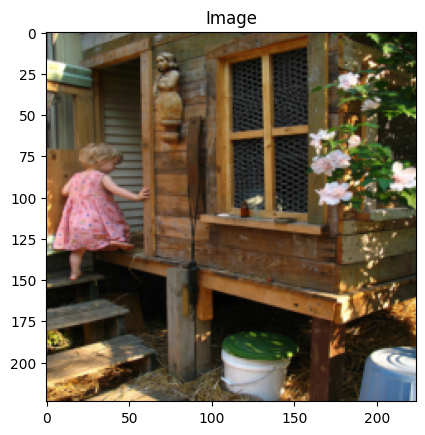

Token : tensor([  1,   4,  28,   8,   4, 195, 151,  17,  32,  67,   4, 353,  11, 711,
          8,  24,   3, 496,   5,   2])
Sentence: 
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']


In [26]:
img, caps = dataset[0]
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

In [27]:
class CapsCollate:
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
        
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
#         print(f"shape - {(imgs)}")
#         print("----"*22)
        imgs = torch.cat(imgs,dim=0)
#         print(f"shape - {imgs}")
#         print("------")
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

"creating the data loader to load the dataset in batches."

In [28]:
#writing the dataloader
#setting the constants
BATCH_SIZE = 4
NUM_WORKER = 2

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]

data_loader = DataLoader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
)

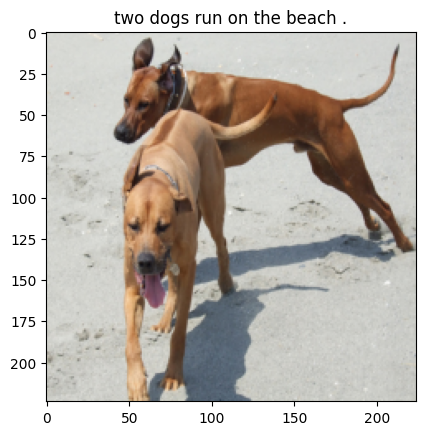

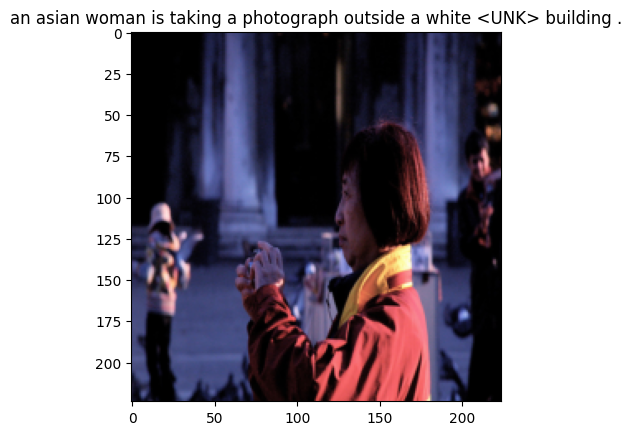

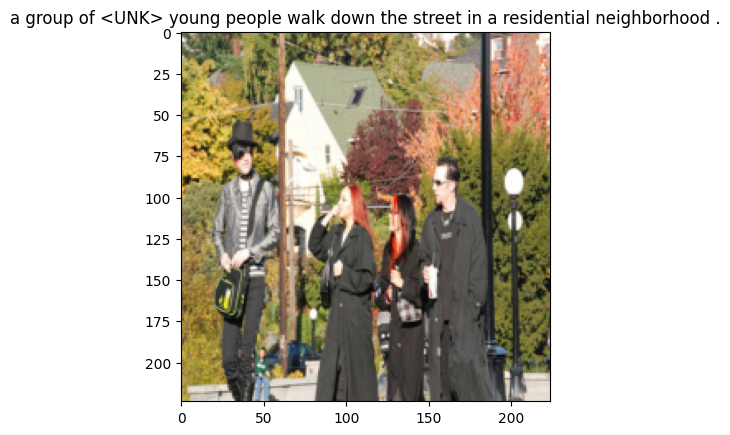

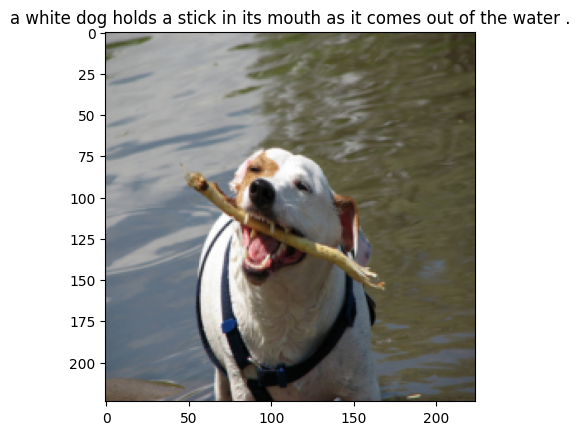

In [29]:
#generating the iterator from the dataloader
dataiter = iter(data_loader)

#getting the next batch
batch = next(dataiter)

#unpacking the batch
images, captions = batch

#showing info of image in single batch
for i in range(BATCH_SIZE):
    img,cap = images[i],captions[i]
#     print(f"captions - {captions[i]}")
    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
    eos_index = caption_label.index('<EOS>')
    caption_label = caption_label[1:eos_index]
    caption_label = ' '.join(caption_label)                      
    show_image(img,caption_label)
    plt.show()

In [30]:
import torch
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim

In [30]:
# vgg16 = models.resnet50(pretrained=True)
# for param in vgg16.parameters():
#     param.requires_grad_(False)
# modules = list(vgg16.children())[:-1]
# print(dir(vgg16))

# ENCODERCNN class

This class is where the feature extraction model is there. We utilized two feature extractors: **VGG16 **and **resnet50**. There are several others that can also be used. Care must be taken to ensure the output and the input given to the instance of this class as that may cause the feature extractor to either work properly or raise errors. 

Here we are using the vgg16 pretrained model.

In [31]:
class EncoderCNN(nn.Module):
    def __init__(self, embed_size):
        super(EncoderCNN, self).__init__()
        vgg16 = models.vgg16(pretrained=True)
        for param in vgg16.parameters():
            param.requires_grad_(False)
        
        modules = list(vgg16.features.children()) + [nn.AdaptiveAvgPool2d((7, 7))]
        self.vgg16 = nn.Sequential(*modules)
        
        # Replace the last linear layer
        in_features = vgg16.classifier[-1].in_features
        classifier = list(vgg16.classifier.children())[:-1]  # Exclude the last linear layer
        classifier.append(nn.Linear(in_features, embed_size))
        self.classifier = nn.Sequential(*classifier)
        

        

    def forward(self, images):
        features = self.vgg16(images)
        features = features.view(features.size(0), -1)
        features = self.classifier(features)
        return features


class DecoderRNN(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(DecoderRNN,self).__init__()
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.lstm = nn.LSTM(embed_size,hidden_size,num_layers=num_layers,batch_first=True)
        self.fcn = nn.Linear(hidden_size,vocab_size)
        self.drop = nn.Dropout(drop_prob)
    
    def forward(self,features, captions):
        # vectorize the caption
#         print(f"captions - {captions[:,:-1]}")
#         print(f"caption shape - {captions[:,:-1].shape}")
        embeds = self.embedding(captions[:,:-1])
#         print(f"shape of embeds - {embeds.shape}")
        # concat the features and captions
#         print(f"features shape - {features.shape}")
#         print(f"features unsqueeze at index 1 shape - {features.unsqueeze(1).shape}")
        x = torch.cat((features.unsqueeze(1),embeds),dim=1)
#         print(f"shape of x - {x.shape}")
        x,_ = self.lstm(x)
#         print(f"shape of x after lstm - {x.shape}")
        x = self.fcn(x)
#         print(f"shape of x after fcn - {x.shape}")
        return x
    
    def generate_caption(self,inputs,hidden=None,max_len=40,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = inputs.size(0)
        
        captions = []
        
        for i in range(max_len):
            output,hidden = self.lstm(inputs,hidden)
            output = self.fcn(output)
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            inputs = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions]


class EncoderDecoder(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(EncoderDecoder,self).__init__()
        self.encoder = EncoderCNN(embed_size)
        self.decoder = DecoderRNN(embed_size,hidden_size,vocab_size,num_layers,drop_prob)
    
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs
# resenet features shape - torch.Size([4, 2048, 1, 1])
# resenet features viewed shape - torch.Size([4, 2048])
# resenet features embed shape - torch.Size([4, 400])
# caption shape - torch.Size([4, 14])
# shape of embeds - torch.Size([4, 14, 400])
# features shape - torch.Size([4, 400])
# features unsqueeze at index 1 shape - torch.Size([4, 1, 400])
# shape of x - torch.Size([4, 15, 400])
# shape of x after lstm - torch.Size([4, 15, 512])
# shape of x after fcn - torch.Size([4, 15, 2994])

In [32]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

# Setting the hyperparameters.

By changing and tuning these one can get a good model, maybe in few steps. However, we have fixed them to make it easy to compare the models.

In [33]:
# Hyperparameters
embed_size = 400
hidden_size = 512
vocab_size = len(dataset.vocab)
num_layers = 2
learning_rate = 0.0001
num_epochs = 2

In [34]:
# initialize model, loss etc
model = EncoderDecoder(embed_size, hidden_size, vocab_size, num_layers).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:01<00:00, 304MB/s]


Set the num_epochs to 20.

Technically, image caption models are trained for many more epochs, however due to resource(compute units) constraints of the Google Colab, we are limiting the model training to only this many epochs.

For 20 epochs the model took about ~3 hrs.

# Model Training

Epoch: 1 loss: 3.22552 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is jumping on a <UNK> . <EOS>


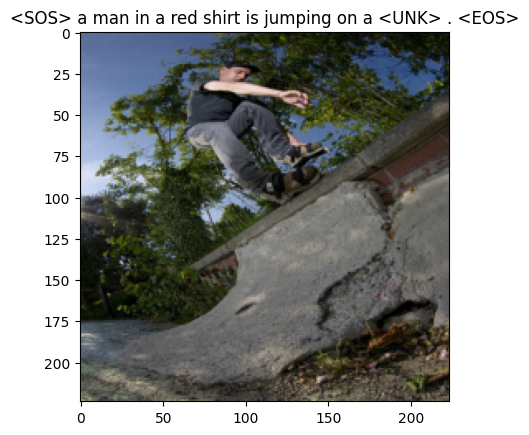

Epoch: 1 loss: 2.91593 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog is running through the water . <EOS>


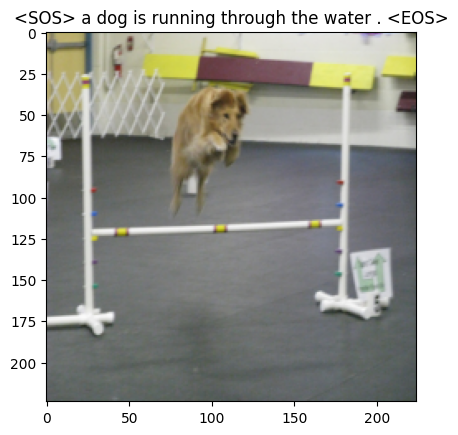

Epoch: 2 loss: 2.30036 iter:4000
features shape - torch.Size([1, 400])
<SOS> a white dog is running through the snow . <EOS>


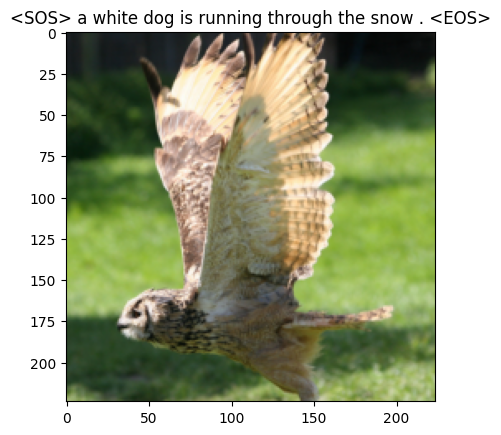

Epoch: 2 loss: 2.49934 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a black shirt is holding a <UNK> . <EOS>


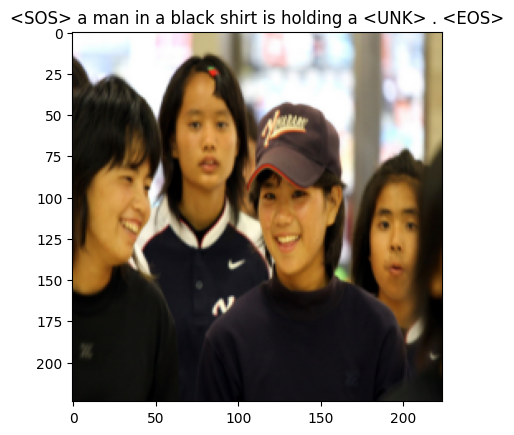

Epoch: 3 loss: 2.74559 iter:4000
features shape - torch.Size([1, 400])
<SOS> two dogs are running through a field . <EOS>


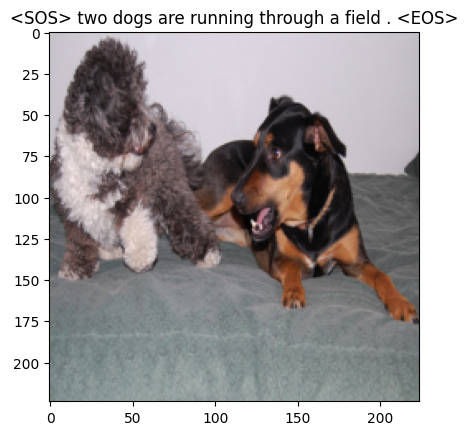

Epoch: 3 loss: 2.45966 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man is riding a bicycle on a dirt road . <EOS>


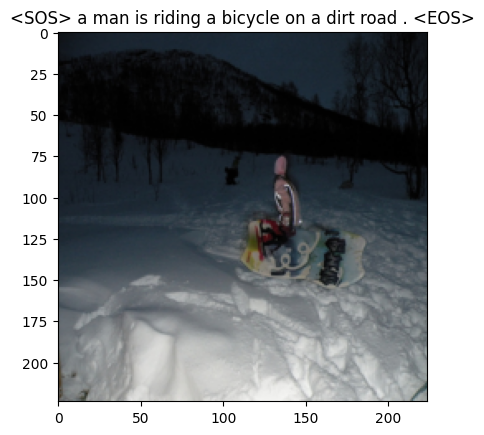

Epoch: 4 loss: 2.37178 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man and a woman are standing in front of a crowd . <EOS>


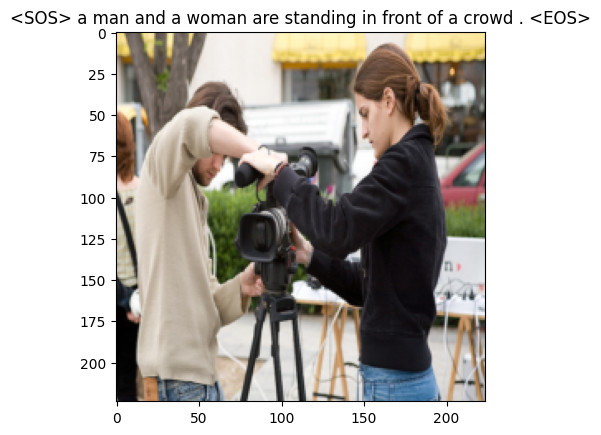

Epoch: 4 loss: 2.66432 iter:8000
features shape - torch.Size([1, 400])
<SOS> a boy in a red uniform is playing soccer . <EOS>


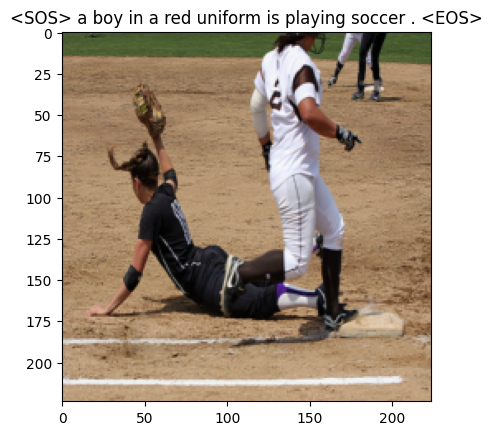

Epoch: 5 loss: 2.15676 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man and a woman are sitting on a bench with a woman in a red shirt . <EOS>


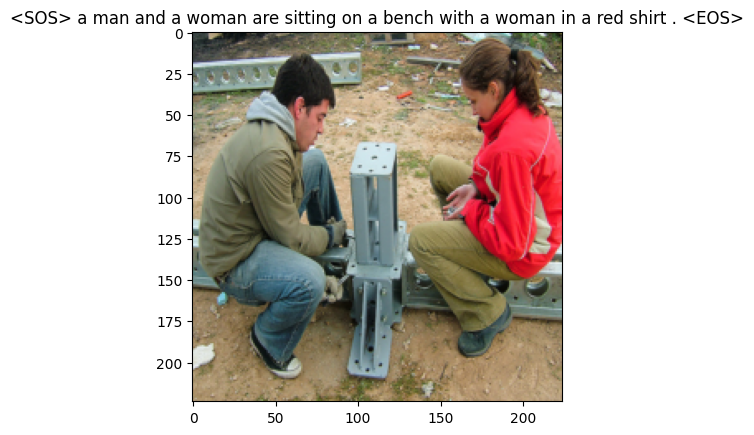

Epoch: 5 loss: 1.80800 iter:8000
features shape - torch.Size([1, 400])
<SOS> a football player in a red and white uniform is being tackled by a player in a red and white uniform . <EOS>


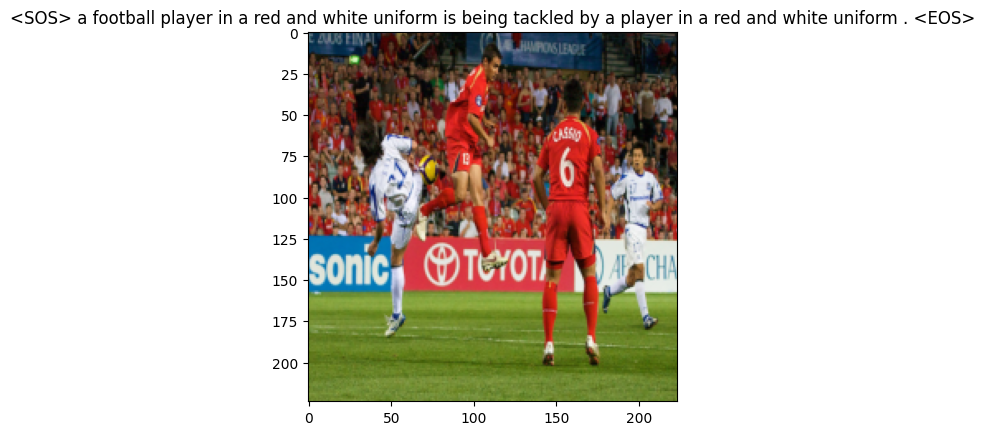

Epoch: 6 loss: 1.67752 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man stands on a rocky hill . <EOS>


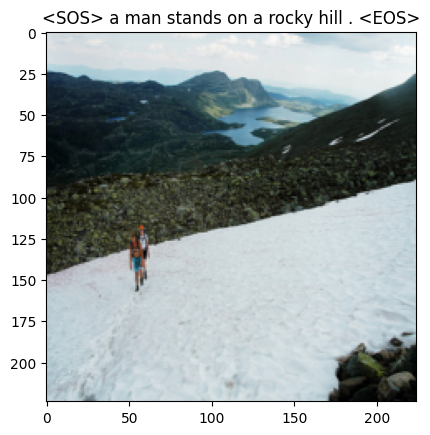

Epoch: 6 loss: 1.63618 iter:8000
features shape - torch.Size([1, 400])
<SOS> a small child is sitting on a bed with a blue blanket in the background . <EOS>


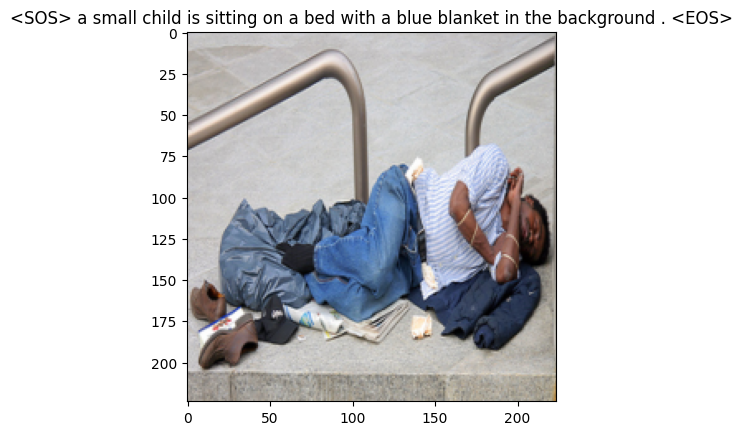

Epoch: 7 loss: 2.12692 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man stands on a field with a fishing pole and a woman in a white shirt . <EOS>


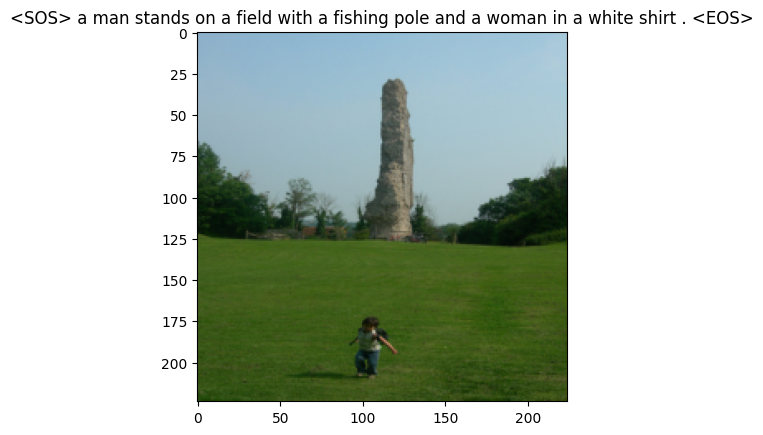

Epoch: 7 loss: 2.03368 iter:8000
features shape - torch.Size([1, 400])
<SOS> a young boy wearing a red shirt is jumping on a trampoline . <EOS>


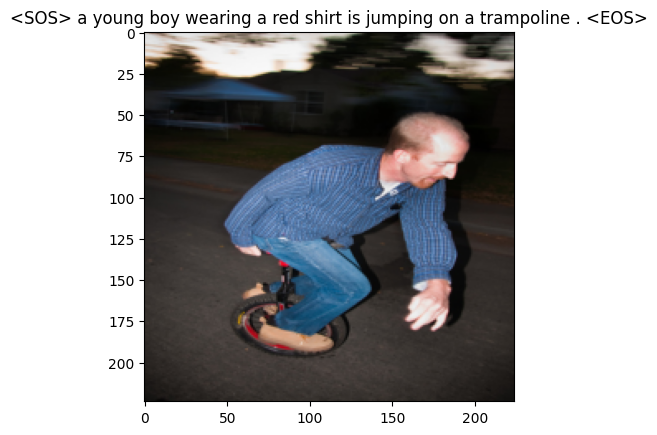

Epoch: 8 loss: 1.65364 iter:4000
features shape - torch.Size([1, 400])
<SOS> a group of people in a line playing with a ball . <EOS>


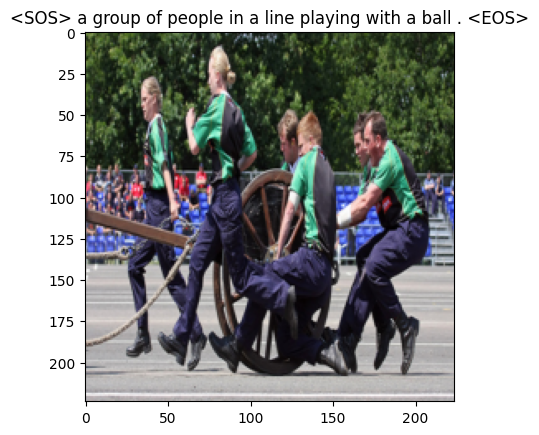

Epoch: 8 loss: 1.84815 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a blue shirt is rock climbing . <EOS>


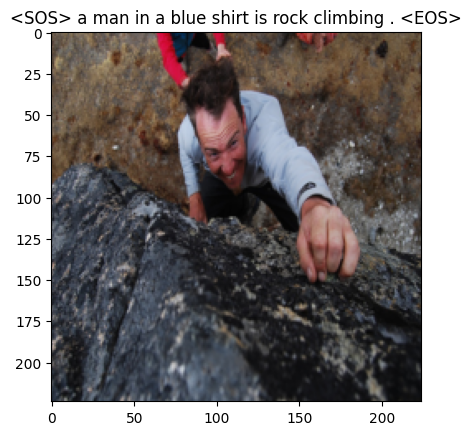

Epoch: 9 loss: 1.55858 iter:4000
features shape - torch.Size([1, 400])
<SOS> a girl in a pink dress is running on a track . <EOS>


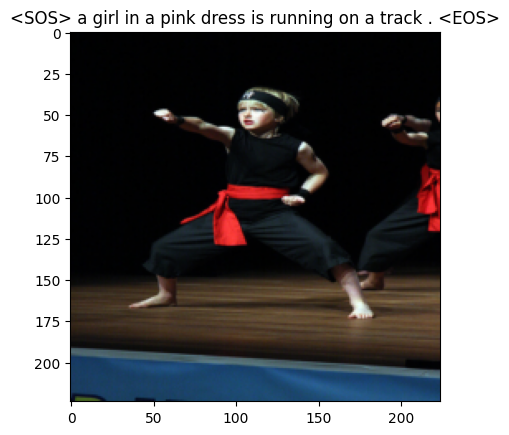

Epoch: 9 loss: 1.98662 iter:8000
features shape - torch.Size([1, 400])
<SOS> a football player in a red jersey is running with the ball . <EOS>


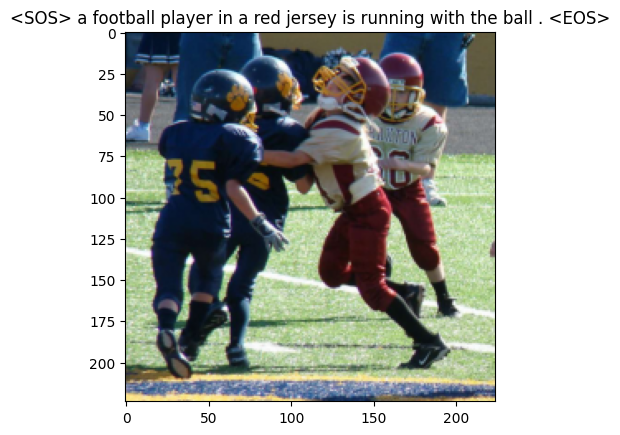

Epoch: 10 loss: 1.93921 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man and a woman are posing for a picture . <EOS>


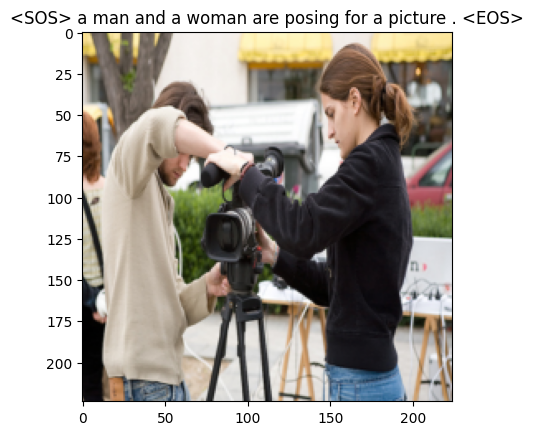

Epoch: 10 loss: 2.23168 iter:8000
features shape - torch.Size([1, 400])
<SOS> three children are playing in a sprinkler . <EOS>


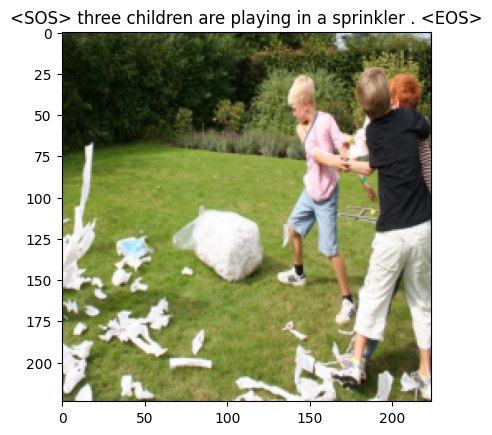

Epoch: 11 loss: 1.87702 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog runs through the grass . <EOS>


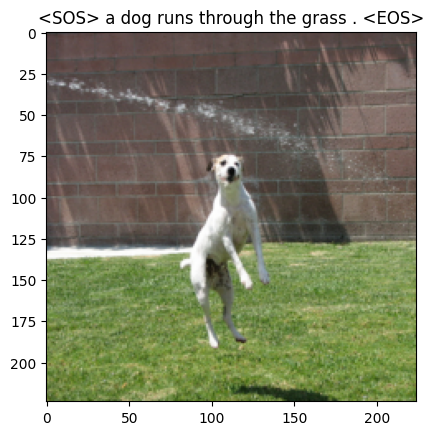

Epoch: 11 loss: 1.69985 iter:8000
features shape - torch.Size([1, 400])
<SOS> a snowboarder is jumping in the air after a jump . <EOS>


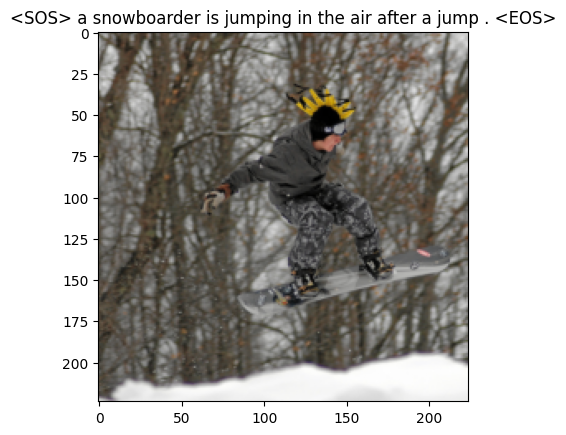

Epoch: 12 loss: 1.48866 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is standing in front of a <UNK> <UNK> train . <EOS>


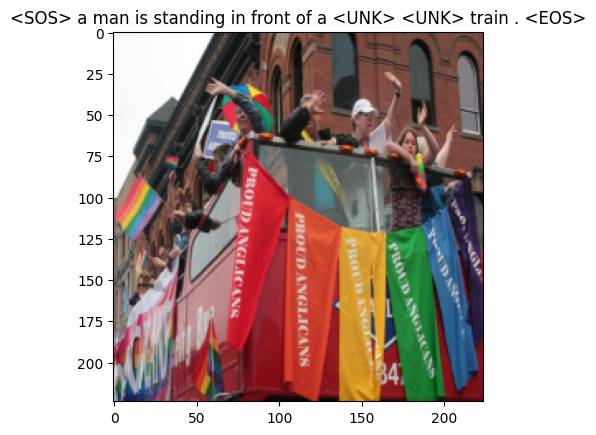

Epoch: 12 loss: 1.53153 iter:8000
features shape - torch.Size([1, 400])
<SOS> a wet dog is running through the water . <EOS>


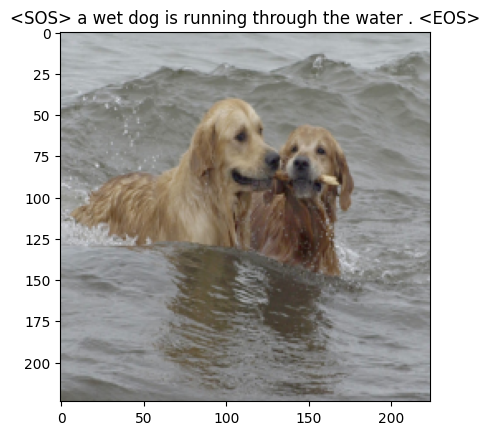

Epoch: 13 loss: 1.45714 iter:4000
features shape - torch.Size([1, 400])
<SOS> a woman in a black shirt is standing in front of a <UNK> display . <EOS>


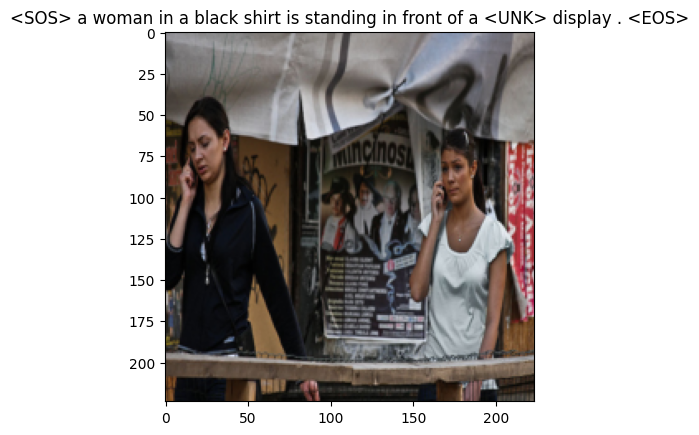

Epoch: 13 loss: 1.48166 iter:8000
features shape - torch.Size([1, 400])
<SOS> a football player in a red jersey is running with the football . <EOS>


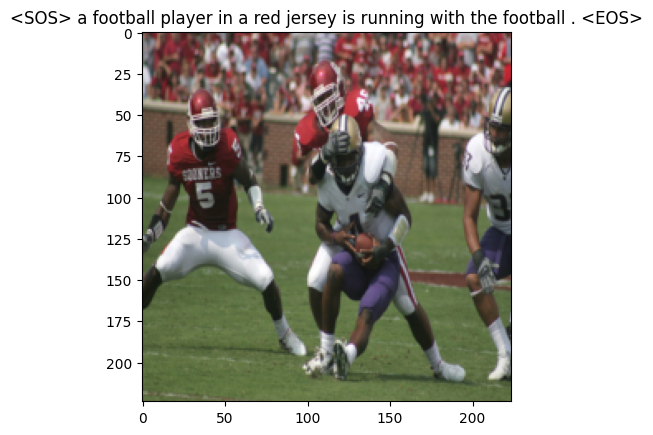

Epoch: 14 loss: 1.54891 iter:4000
features shape - torch.Size([1, 400])
<SOS> three young boys are posing with a man on their hands in the air . <EOS>


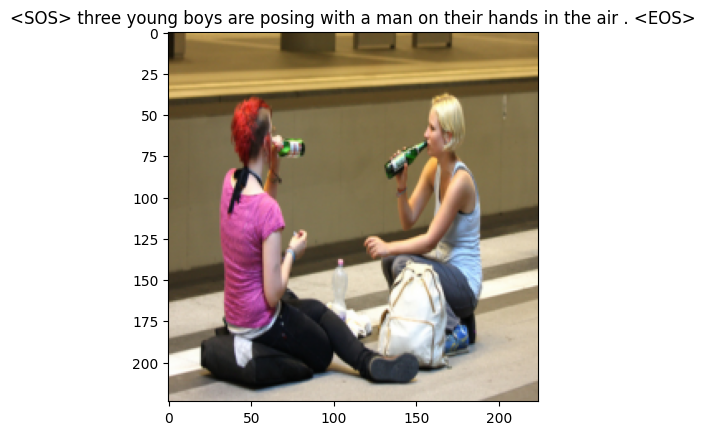

Epoch: 14 loss: 1.49696 iter:8000
features shape - torch.Size([1, 400])
<SOS> a little boy in a red shirt is sitting on a wooden bench . <EOS>


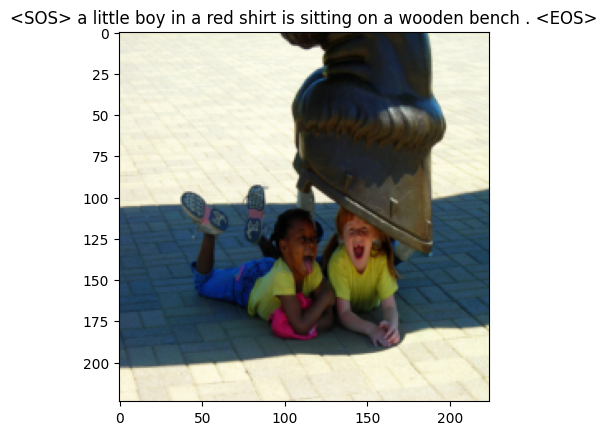

Epoch: 15 loss: 1.42002 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man and a woman are sitting in a rowboat on calm water . <EOS>


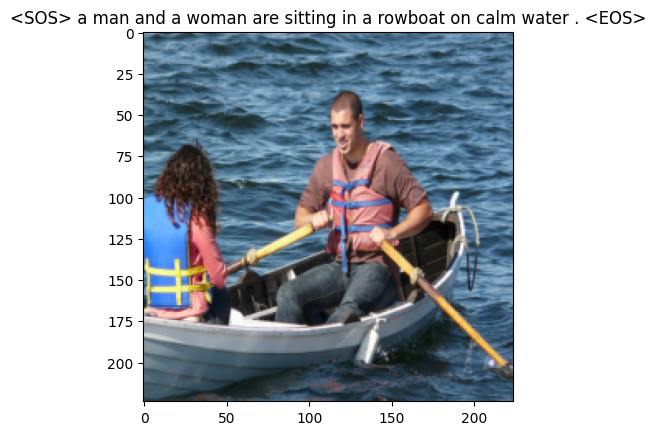

Epoch: 15 loss: 1.02010 iter:8000
features shape - torch.Size([1, 400])
<SOS> two dogs are playing together outside . <EOS>


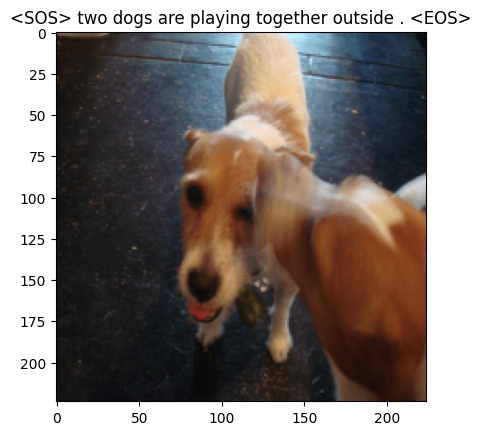

Epoch: 16 loss: 1.03996 iter:4000
features shape - torch.Size([1, 400])
<SOS> a person on a bike is riding on a trail in the mountains . <EOS>


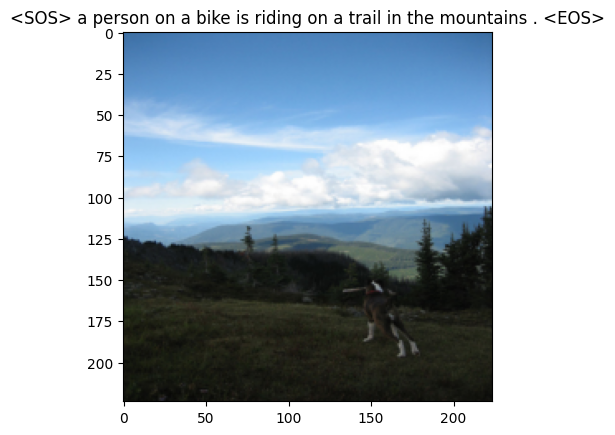

Epoch: 16 loss: 1.49135 iter:8000
features shape - torch.Size([1, 400])
<SOS> a cowboy is being <UNK> to take a horse . <EOS>


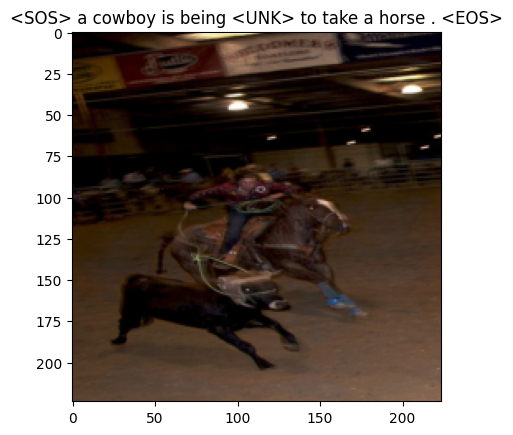

Epoch: 17 loss: 1.35018 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is standing in a crowd of people . <EOS>


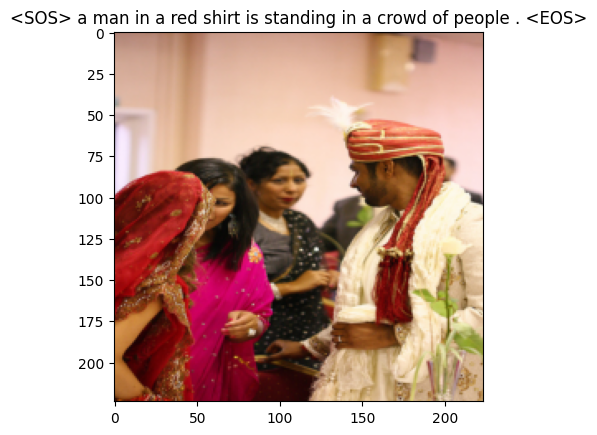

Epoch: 17 loss: 1.43129 iter:8000
features shape - torch.Size([1, 400])
<SOS> a motorcycle racer is <UNK> his turn on a track during a race . <EOS>


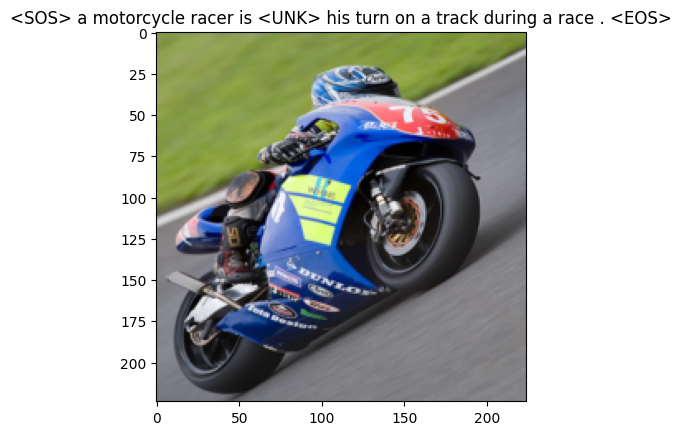

Epoch: 18 loss: 1.16861 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog is <UNK> a man in a blue and yellow suit . <EOS>


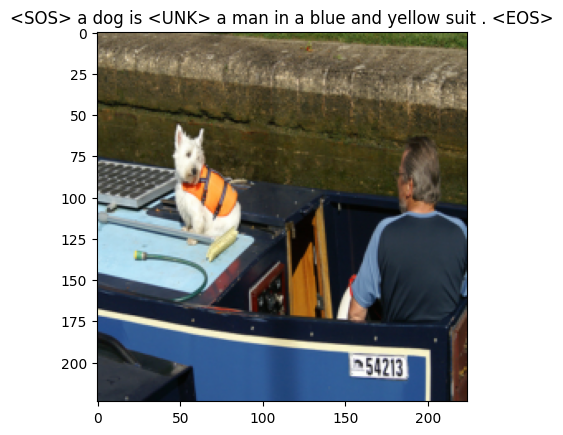

Epoch: 18 loss: 0.95224 iter:8000
features shape - torch.Size([1, 400])
<SOS> a soccer player in a red uniform runs after a ball . <EOS>


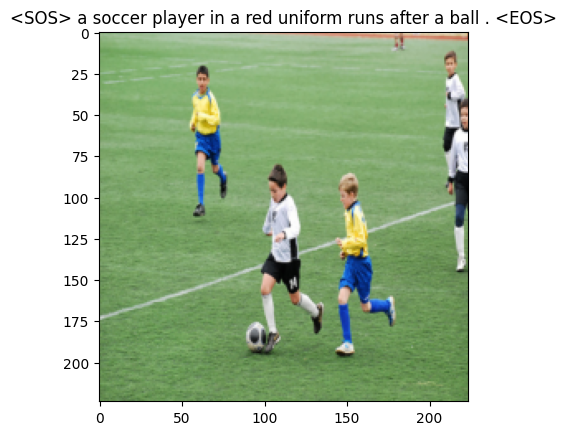

Epoch: 19 loss: 1.00659 iter:4000
features shape - torch.Size([1, 400])
<SOS> three dogs running on a beach with trees in the background . <EOS>


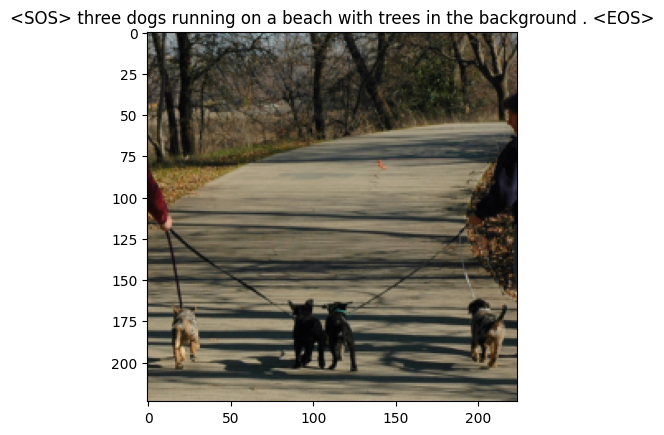

Epoch: 19 loss: 1.24130 iter:8000
features shape - torch.Size([1, 400])
<SOS> a brown dog is digging in the snow . <EOS>


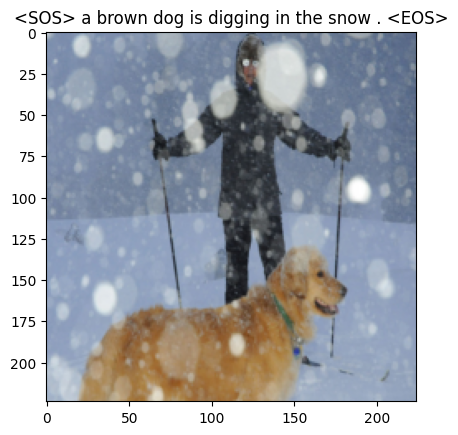

Epoch: 20 loss: 1.00044 iter:4000
features shape - torch.Size([1, 400])
<SOS> a girl in a pink shirt and blue shorts is jumping . <EOS>


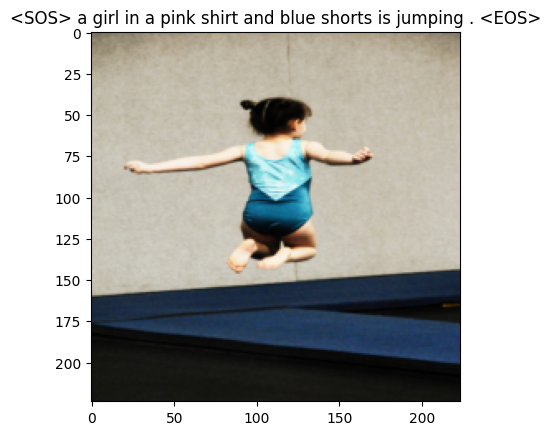

Epoch: 20 loss: 1.51757 iter:8000
features shape - torch.Size([1, 400])
<SOS> a race car drives through a puddle . <EOS>


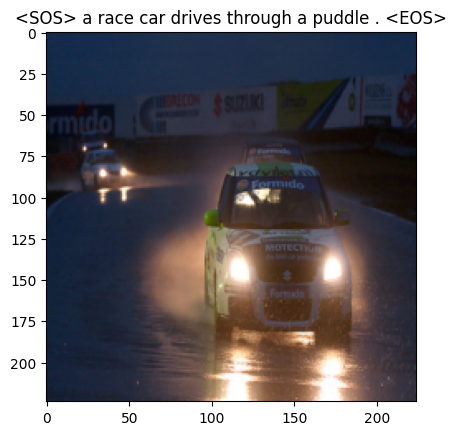

In [35]:
num_epochs = 20
print_every = 4000
loss_iter = []

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in (enumerate(iter(data_loader))):
        image,captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs = model(image, captions)
        
        # Calculate the batch loss.
        loss = criterion(outputs.view(-1, vocab_size), captions.view(-1))

        
        # Backward pass.
        loss.backward()

        # Update the parameters in the optimizer.
        optimizer.step()

        writer.add_scalar("Training loss/epoch", loss.item(), global_step = idx)
        
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f} iter:{}".format(epoch,loss.item(),idx+1))

            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                print(f"features shape - {features.shape}")
                caps = model.decoder.generate_caption(features.unsqueeze(0),vocab=dataset.vocab)
                caption = ' '.join(caps)
                print(caption)
                show_image(img[0],title=caption)
                
            model.train()



# Loading the Tensorboard 

In [36]:
%load_ext tensorboard
%tensorboard --logdir /content/vgg16_lstm --port 8088

<IPython.core.display.Javascript object>

Using the Tensorboard for Scalars and setting the horizontal axis as steps doesn't provides a good understanding of the model. However, by changing the horizonrtal axis to relative and/or to wall assists in better understanding of the model.

### The reason it doesn't works good for step, is due to the fact that for ***each epoch*** the model is getting trained for ***10,000 steps.*** 

And by setting the horizontal axis as **step** we see the loses for all the 20 epochs as well. 

Thus, going relative and/or wall shows much better.

Another way to get the same thing but for step is to create a new variable steps that keeps on increasing by +1 at each cycle and simply, setting the `global_step = steps` before starting the training loop as follows:



```
writer.add_scalar("Training loss/epoch", loss.item(), global_step = steps)
steps+=1
```

steps is initialised before the outer epoch loop

# Testing the model

In this step we take a random image from the testing sample( size : 455), find its generated caption and then find the bleu-scores by comparing the original/human captions to the generated/predicted caption.

In [37]:
import random
import pandas as pd
def testing():
  img_no = random.randrange(0,455,5)
  test_data_df = pd.read_csv(test_data_location)
  img_name = test_data_df['image'][img_no]
  original = test_data_df[test_data_df['image'] == img_name]['caption'].tolist()
  ref = []
  for i in original:
    ref.append([token.text.lower() for token in spacy_eng.tokenizer(i)])
  
  print('image_name : \t', img_name)
  print('original_captions: \t', original)
  print('references to be passed: \t', ref)
  model.eval()
  with torch.no_grad():
    img_location = os.path.join(image_data_location,img_name)
    img = Image.open(img_location).convert("RGB")
    transformed_image = transforms(img)
    show_image(transformed_image)
    features = model.encoder(transformed_image.unsqueeze(0).to(device))
    caps = model.decoder.generate_caption(features.unsqueeze(0), vocab = dataset.vocab)
    _1,_2,_3,_4 = bleu_score(ref, caps)
    return _1, _2, _3, _4


# Finding the bleu scores

In [38]:
from nltk.translate.bleu_score import SmoothingFunction
smoothie = SmoothingFunction().method4
def bleu_score(original_captions, generated_caption):
  generated_caption.remove('<SOS>')
  generated_caption.remove('<EOS>')
  print('BLEU Scores :')
  print('A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.')
  b_1 = sentence_bleu(original_captions, generated_caption, weights=(1.0, 0, 0, 0))
  b_2 = sentence_bleu(original_captions, generated_caption, weights=(0.5, 0.5, 0, 0))
  b_3 = sentence_bleu(original_captions, generated_caption, weights=(0.3, 0.3, 0.3, 0), smoothing_function  = smoothie)
  b_4 = sentence_bleu(original_captions, generated_caption, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function = smoothie)

  print("\ngenerated-caption : \t" , ' '.join(generated_caption))

  print('BLEU-1: %f' % b_1)
  print('BLEU-2: %f' % b_2)
  print('BLEU-3: %f' % b_3)
  print('BLEU-4: %f' % b_4)

  return b_1, b_2, b_3, b_4


# FInding the average bleu-scores of 10 random samples(images) from the testing data.


*****NEW_INPUT*******



image_name : 	 947969010_f1ea572e89.jpg
original_captions: 	 ['A black dog with a brown muzzle next to a body of water , shaking off water with a stick in its mouth .', 'A black dog with a red collar has an item in his mouth and is climbing out of a pool .', 'A brown dog climbing out of a pool with a stick in his mouth .', 'A dog with a stick in its mouth climbs out of the water .', 'The dog is climbing out of the water with a stick .']
references to be passed: 	 [['a', 'black', 'dog', 'with', 'a', 'brown', 'muzzle', 'next', 'to', 'a', 'body', 'of', 'water', ',', 'shaking', 'off', 'water', 'with', 'a', 'stick', 'in', 'its', 'mouth', '.'], ['a', 'black', 'dog', 'with', 'a', 'red', 'collar', 'has', 'an', 'item', 'in', 'his', 'mouth', 'and', 'is', 'climbing', 'out', 'of', 'a', 'pool', '.'], ['a', 'brown', 'dog', 'climbing', 'out', 'of', 'a', 'pool', 'with', 'a', 'stick', 'in', 'his', 'mouth', '.'], ['a', 'dog', 'with', 'a', 'stick', 'in', 'its', 'mouth', 'climbs'

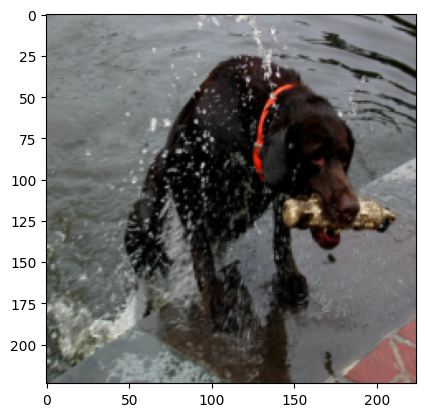

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a black dog with a red collar is jumping in the water .
BLEU-1: 0.923077
BLEU-2: 0.784465
BLEU-3: 0.720728
BLEU-4: 0.605329

*****NEW_INPUT*******



image_name : 	 96420612_feb18fc6c6.jpg
original_captions: 	 ['A man in red swim trunks is jumping onto a bodyboard .', 'A man in red trunks flies through the air with a boogie board .', 'A man with a wake-board is diving over a surface that is not water .', 'A shirtless man bodysurfs .', 'Man is diving onto his wakeboard .']
references to be passed: 	 [['a', 'man', 'in', 'red', 'swim', 'trunks', 'is', 'jumping', 'onto', 'a', 'bodyboard', '.'], ['a', 'man', 'in', 'red', 'trunks', 'flies', 'through', 'the', 'air', 'with', 'a', 'boogie', 'board', '.'], ['a', 'man', 'with', 'a', 'wake', '-', 'board', 'is', 'diving', 'over', 'a', 'surface', 'that', 'is', 'not', 'water', '.'], ['a', 'shirtless', 'man', 'bodysurfs

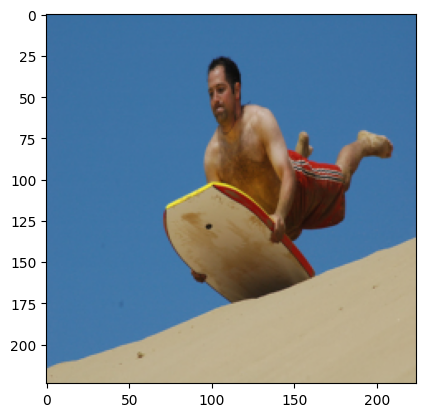

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man is jumping into the ocean .
BLEU-1: 0.750000
BLEU-2: 0.566947
BLEU-3: 0.259456
BLEU-4: 0.123369

*****NEW_INPUT*******



image_name : 	 909191414_1cf5d85821.jpg
original_captions: 	 ['A boy is leaping over a blue hose pipe as a little girl watches .', 'A boy is leaping while his sister plays around a hose .', 'A young boy jumping in front of a young girl and a house .', 'Children are playing in and around a garden tube in the front yard of a house .', 'Two children playing above a blue water hose .']
references to be passed: 	 [['a', 'boy', 'is', 'leaping', 'over', 'a', 'blue', 'hose', 'pipe', 'as', 'a', 'little', 'girl', 'watches', '.'], ['a', 'boy', 'is', 'leaping', 'while', 'his', 'sister', 'plays', 'around', 'a', 'hose', '.'], ['a', 'young', 'boy', 'jumping', 'in', 'front', 'of', 'a', 'young', 'girl', 'and', 'a', 'house', '.'], ['children', 'a

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


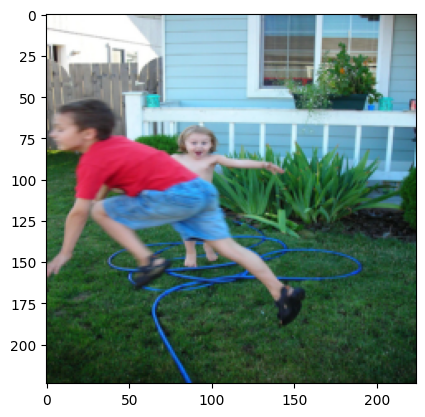

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man and a woman are sitting on a park bench with their arms around each other .
BLEU-1: 0.388889
BLEU-2: 0.151248
BLEU-3: 0.096575
BLEU-4: 0.044669

*****NEW_INPUT*******



image_name : 	 95728660_d47de66544.jpg
original_captions: 	 ['A guy is riding a bike up the side of a hill .', 'A young man bicycles towards the camera and away from beautiful mountains on a clear day .', 'Man on bike in mountains', 'Man riding a bicycle down a narrow path .', 'man riding bike on trail']
references to be passed: 	 [['a', 'guy', 'is', 'riding', 'a', 'bike', 'up', 'the', 'side', 'of', 'a', 'hill', '.'], ['a', 'young', 'man', 'bicycles', 'towards', 'the', 'camera', 'and', 'away', 'from', 'beautiful', 'mountains', 'on', 'a', 'clear', 'day', '.'], ['man', 'on', 'bike', 'in', 'mountains'], ['man', 'riding', 'a', 'bicycle', 'down', 'a', 'narrow', 'path', '.'], ['man', 'ri

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


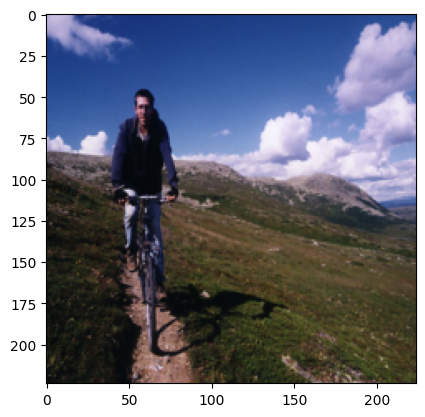

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a woman in a red shirt is walking through a grassy field .
BLEU-1: 0.461538
BLEU-2: 0.000000
BLEU-3: 0.065800
BLEU-4: 0.029305

*****NEW_INPUT*******



image_name : 	 909808296_23c427022d.jpg
original_captions: 	 ['A brown and black dog on a leash is sniffed by a black and white dog .', 'A dog on a leash walks on the sidewalk while another dog follows .', 'A small dog on a leash is being smelled by another animal .', 'The black and white dog is sniffing the butt of the brown dog that is on a leash .', 'Two small dogs , one black-and-white and one brown-and-black , walk down the street .']
references to be passed: 	 [['a', 'brown', 'and', 'black', 'dog', 'on', 'a', 'leash', 'is', 'sniffed', 'by', 'a', 'black', 'and', 'white', 'dog', '.'], ['a', 'dog', 'on', 'a', 'leash', 'walks', 'on', 'the', 'sidewalk', 'while', 'another', 'dog', 'follows', '.'], ['a', 

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

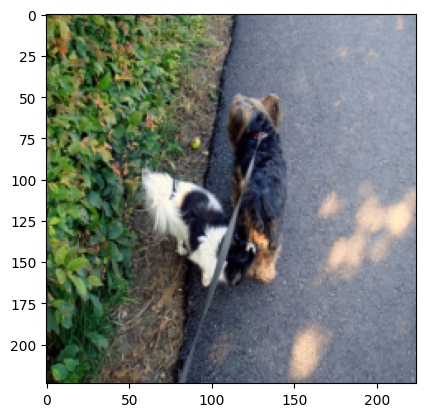

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog runs through a field .
BLEU-1: 0.242499
BLEU-2: 0.130964
BLEU-3: 0.079147
BLEU-4: 0.041352

*****NEW_INPUT*******



image_name : 	 979383193_0a542a059d.jpg
original_captions: 	 ['A group of six children sit at a wooden table .', 'A group of young asian children pose for a picture at a table .', 'Six children , all with black hair , sit at a table for a picture .', 'Six children at a table .', 'Six small children sitting at a desk .']
references to be passed: 	 [['a', 'group', 'of', 'six', 'children', 'sit', 'at', 'a', 'wooden', 'table', '.'], ['a', 'group', 'of', 'young', 'asian', 'children', 'pose', 'for', 'a', 'picture', 'at', 'a', 'table', '.'], ['six', 'children', ',', 'all', 'with', 'black', 'hair', ',', 'sit', 'at', 'a', 'table', 'for', 'a', 'picture', '.'], ['six', 'children', 'at', 'a', 'table', '.'], ['six', 'small', 'children', 'sitting'

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


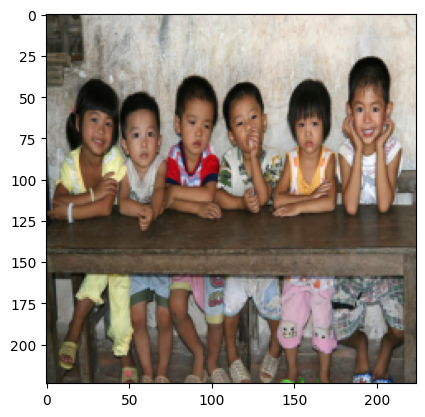

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a group of children sit on the steps and smile .
BLEU-1: 0.545455
BLEU-2: 0.404520
BLEU-3: 0.300532
BLEU-4: 0.152790

*****NEW_INPUT*******



image_name : 	 957682378_46c3b07bcd.jpg
original_captions: 	 ['A brown dog and a black dog run into each other in the grass .', 'A brown dog is grabbing the collar of a black dog .', 'A dark black dog is playing with a light brown dog in a backyard .', 'Two dogs are wrestling in a field .', 'Two dogs are wrestling in the park .']
references to be passed: 	 [['a', 'brown', 'dog', 'and', 'a', 'black', 'dog', 'run', 'into', 'each', 'other', 'in', 'the', 'grass', '.'], ['a', 'brown', 'dog', 'is', 'grabbing', 'the', 'collar', 'of', 'a', 'black', 'dog', '.'], ['a', 'dark', 'black', 'dog', 'is', 'playing', 'with', 'a', 'light', 'brown', 'dog', 'in', 'a', 'backyard', '.'], ['two', 'dogs', 'are', 'wrestling', 'in', 'a', 'f

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


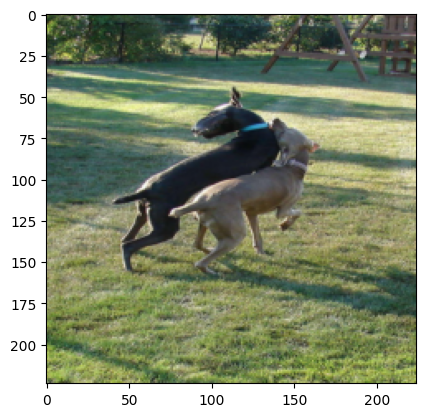

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog runs through the grass .
BLEU-1: 0.619198
BLEU-2: 0.422993
BLEU-3: 0.347770
BLEU-4: 0.190182

*****NEW_INPUT*******



image_name : 	 888425986_e4b6c12324.jpg
original_captions: 	 ['A boy is upside down in midair near a lake at sunset .', 'A person does a flip by two sailboats and a lake .', 'A person flipping upside down', 'a person in midair doing a back flip .', 'A person is doing a flip in midair near a lake with sails behind him .']
references to be passed: 	 [['a', 'boy', 'is', 'upside', 'down', 'in', 'midair', 'near', 'a', 'lake', 'at', 'sunset', '.'], ['a', 'person', 'does', 'a', 'flip', 'by', 'two', 'sailboats', 'and', 'a', 'lake', '.'], ['a', 'person', 'flipping', 'upside', 'down'], ['a', 'person', 'in', 'midair', 'doing', 'a', 'back', 'flip', '.'], ['a', 'person', 'is', 'doing', 'a', 'flip', 'in', 'midair', 'near', 'a', 'lake', 'with', '

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


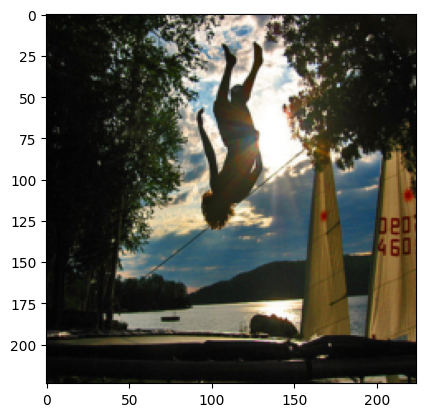

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man is standing on a platform with a small flag on it with a black and white sail on it .
BLEU-1: 0.318182
BLEU-2: 0.000000
BLEU-3: 0.046514
BLEU-4: 0.019587

*****NEW_INPUT*******



image_name : 	 95728660_d47de66544.jpg
original_captions: 	 ['A guy is riding a bike up the side of a hill .', 'A young man bicycles towards the camera and away from beautiful mountains on a clear day .', 'Man on bike in mountains', 'Man riding a bicycle down a narrow path .', 'man riding bike on trail']
references to be passed: 	 [['a', 'guy', 'is', 'riding', 'a', 'bike', 'up', 'the', 'side', 'of', 'a', 'hill', '.'], ['a', 'young', 'man', 'bicycles', 'towards', 'the', 'camera', 'and', 'away', 'from', 'beautiful', 'mountains', 'on', 'a', 'clear', 'day', '.'], ['man', 'on', 'bike', 'in', 'mountains'], ['man', 'riding', 'a', 'bicycle', 'down', 'a', 'narrow', 'path', '.'], [

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

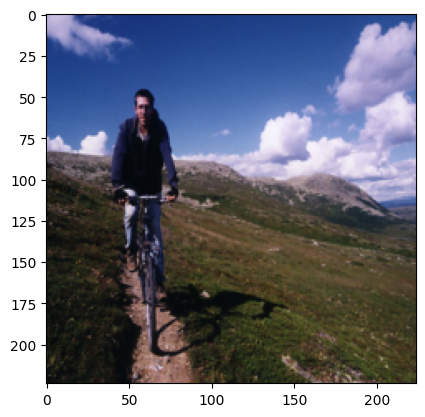

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a woman in a red shirt is walking through a grassy field .
BLEU-1: 0.461538
BLEU-2: 0.000000
BLEU-3: 0.065800
BLEU-4: 0.029305

*****NEW_INPUT*******



image_name : 	 98377566_e4674d1ebd.jpg
original_captions: 	 ['Two brown and white dogs lift their ears and look through a fence .', 'Two little dogs looking out of their cage .', 'Two small dogs are in a cage outside .', 'Two small dogs in a cage .', 'Two white and brown dogs up against a fence .']
references to be passed: 	 [['two', 'brown', 'and', 'white', 'dogs', 'lift', 'their', 'ears', 'and', 'look', 'through', 'a', 'fence', '.'], ['two', 'little', 'dogs', 'looking', 'out', 'of', 'their', 'cage', '.'], ['two', 'small', 'dogs', 'are', 'in', 'a', 'cage', 'outside', '.'], ['two', 'small', 'dogs', 'in', 'a', 'cage', '.'], ['two', 'white', 'and', 'brown', 'dogs', 'up', 'against', 'a', 'fence', '.']]


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

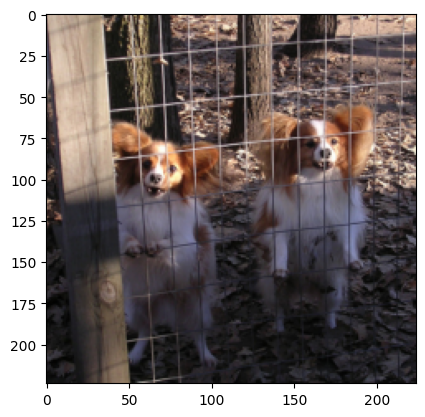

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog is jumping over a small pool .
BLEU-1: 0.333333
BLEU-2: 0.000000
BLEU-3: 0.070343
BLEU-4: 0.033866

****FINDING AVERAGE SCORES****

Average_BLEU-1_score_for_the_above_printed_images: 0.504371
Average_BLEU-2_score_for_the_above_printed_images: 0.246114
Average_BLEU-3_score_for_the_above_printed_images: 0.205267
Average_BLEU-4_score_for_the_above_printed_images: 0.126976


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

In [39]:
b_1 = []
b_2 = []
b_3 = []
b_4 = []
for i in range(10):
  print('\n*****NEW_INPUT*******\n')
  print('\n')
  _1, _2, _3, _4 = testing()
  b_1.append(_1)
  b_2.append(_2)
  b_3.append(_3)
  b_4.append(_4)

print('\n****FINDING AVERAGE SCORES****\n')
from statistics import mean
print('Average_BLEU-1_score_for_the_above_printed_images: %f' % mean(b_1))
print('Average_BLEU-2_score_for_the_above_printed_images: %f' % mean(b_2))
print('Average_BLEU-3_score_for_the_above_printed_images: %f' % mean(b_3))
print('Average_BLEU-4_score_for_the_above_printed_images: %f' % mean(b_4))

**FROM THE ABOVE WE CAN CLEARLY UNDERSTAND ON THING :**

***THE MODEL IS PRIORITISING SINGLE WORDS OVER A COMPLETED AND BETTER SENTENCE***

THIS IS DUE TO **`argmax`** function used while generating captions.
 

*As can be seen from above the average values of bleu_scores. These values indicate that 1-gram bleu-score is better while 4-gram bleu score is not good. This attributes to the above stated fact that the model is preferring individual words over the complete sentences. This could potentially be solved somewhat by using beam-search based prediction method and utilizing attention layers.*

However, the key point to notice here is that the average is calculated by randomly choosing only 10 images. These Average scores can potentially increase/dexrease by taking a bigger sample or just by rerunning the testing the above loop.

However, an easier way to do is to increase the number of training epochs. One can try to train their own individual model by taking these as a starting point to further train models for more epochs and/or try beam-search based prediction techniques.  